<a href="https://colab.research.google.com/github/zoektt/python-random-quote/blob/master/Copy_of_Project2_Team2_Final_Report_20210508.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Online Food/Grocery Delivery Demand Forecast and Distribution of Resources Analysis

Team 2: Tan Tan Zoe KWAN (tantank), Kevin Shanglin Cai (shanglic)

Project video link: 

longer version:
https://youtu.be/Sy65lZAVrSg

shorter version:
https://www.youtube.com/watch?v=A_39mwzC-MU

**1. Project Motivation:**

After the Coronavirus outbreak, grocery delivery companies and food delivery service providers like Instacart, Deliveroo, JustEat, Postmates and UberEat orders have skyrocketed as consumers have to stay at home. By 2025, online grocery is expected to hit 22%—or $250 billion—of total US grocery sales. The figure was just 5% in 2019, according to a report from Bain.

Professor mentioned that in class and we also see the news talking about the potential growth of this industry, even after the pandemic, as purchasing habits has already been shifted. One of the project teammates will kickstart an internship at a retail giant so hopefully we can apply the demand forecast or resource allocation analysis to our future job as well.

The dataset is rather limited, but we can always expand the initiative when running in-house data, just like UberEat has been using the internal [Michelangelo](https://eng.uber.com/scaling-michelangelo/) platform to estimates meal arrival times.


**2. News/Articles triger our interest:**

The article that inspire us to explore the food delivery industry is [The pandemic has more than doubled food-delivery apps’ business. Now what?](https://www.marketwatch.com/story/the-pandemic-has-more-than-doubled-americans-use-of-food-delivery-apps-but-that-doesnt-mean-the-companies-are-making-money-11606340169)
. How to best allocate the resources for the delivery has came to our mind. If we can utilize machine learning model to predict the demand, we can easily allocate enough delivery crew to fullfill people needs. 

Below are more research and industry reports that further trigger our interest: 
- [QUARTZ](https://qz.com/1940943/how-instacart-became-essential-in-the-pandemic/)
- [Research and Markets](https://www.researchandmarkets.com/issues/food-delivery-on-the-rise?utm_source=dynamic&utm_medium=GNOM&utm_code=bsnq5l&utm_campaign=1383480+-+Food+Delivery+Services+See+a+Surge+in+Demand+due+to+Coronavirus+Outbreak+as+Consumers+Stay+at+Home&utm_exec=joca220gnomd)
- [Business Insider](https://www.businessinsider.com/instacart-13-biggest-online-grocery-delivery-challengers-doordash-gopuff-2021-4)
- [PRNewsWire](https://www.prnewswire.com/news-releases/instacart-unveils-beyond-the-cart-a-year-of-essential-insights-trends-report-revealing-how-the-pandemic-has-transformed-100-years-of-consumer-grocery-habits-301262579.html)

**3. Overview of the project goals.**

Consumers have higher expections on the delivery service experience these days, from delivery speed to accessibility. So we plan to run **supervised learning model, i.e. Regression analysis** with the dataset, **to predict the number of orders in a given week (Task)**.  We will do a split of the data into training and test set, so the **Experience E is the training data**. The **Performance matrix will be the Mean Squared Error (MSE) and R2 value**.

The other plan we have is to run **Neural Network** with the dataset, **to predict the number of orders across time (Task)**.  We will do a split of the data into training and test set, so the **Experience E is the training data**. The **Performance matrix will be the Mean Squared Error (MSE) and R2 value**.

This can help the delivery platforms to better forecast demand, plan order assignment to riders, and also benefited the freelance runners and riders to better plan their work schedule.

**4. Data Source:**

The data source that we plan to use is kaggle Meal Delivery Company time-series dataset. The whole dataset includes four files. The data is fully clean and ready for analyzed. The training dataset includes 457k weekly data for each of the center id.


*   **fulfilment_center_info.csv** 
  *   Contains information for each fulfillment center
  *   Columns includes: center_id,city_code,region_code,center_type,op_area
*   **meal_info.csv**
  *   Contains information for each meal being served
  *   Columns includes: meal_id,category,cuisine
*   **test.csv**
  *   Historical time-series Demand Data from week 146 to week 155
    *   Columns includes: id,week,center_id,checkout_price,base_price,emailer_for_promotion,homepage_featured
*   **train.csv**
  *   Historical time-series Demand Data from week 1 to week 145
  *   Columns includes: id,week,center_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders


Datasource Link:
[Meal_Delivery_Data](https://www.kaggle.com/ghoshsaptarshi/av-genpact-hack-dec2018?select=train.csv)


## Key Takeaway of project
Due to the limitations in the dataset (without accurate date details), we can only predict the future number of others without much consideration of the seasonality, such as weekend/weekdays, or day in a year, festivals, etc. If taken into account of these factors given the real life data / internal data, more insights can be found.

The key value of the project is that we can still predict the number of orders based on week number (considering the recency), center, meal price, email promotino and homepage featuers, and make related operations decision and resource changes.

## Data Loading

Before jumping to the machine learning process, we would like to join the ready-made training and testing dataset with the upstream data, the fulfillment centre details and the meal details, to understand characteristics and trends in general.

In [ ]:
import pandas as pd

In [ ]:
def load_data():
    center_info=pd.read_csv("./Data/fulfilment_center_info.csv")
    meal_info=pd.read_csv("./Data/meal_info.csv")
    test=pd.read_csv("./Data/test.csv")
    train=pd.read_csv("./Data/train.csv")
    
    test_center_info=pd.merge(test, center_info, on=["center_id", "center_id"])
    final_test=pd.merge(meal_info, test_center_info, on=["meal_id", "meal_id"])
    
    train_center_info=pd.merge(train, center_info, on=["center_id", "center_id"])
    final_train=pd.merge(meal_info, train_center_info, on=["meal_id", "meal_id"])
    return final_test,final_train

In [ ]:
test,train=load_data()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Exploratory data analysis

The questions we would like to explore are listed below:

### Which fulfillment centre (`center_id`) has the **most** and the **least** number of orders (`num_orders`) ?

In [ ]:
import altair as alt
num_order=train.groupby("center_id").sum()
num_order.reset_index(inplace=True)
top_10_number_order=num_order.sort_values(by=['num_orders'],ascending=False).head(10)
top_10_number_order_bar=alt.Chart(top_10_number_order).mark_bar().encode(
    x=alt.X('center_id:N', sort='-y'),
    y='num_orders'
).properties(
    title='The Fulfillment Centre with the Most Number of Orders'
)

tail_10_number_order=num_order.sort_values(by=['num_orders'],ascending=False).tail(10)
tail_10_number_order_bar=alt.Chart(tail_10_number_order).mark_bar().encode(
    x=alt.X('center_id:N', sort='y'),
    y='num_orders',
).properties(
    title='The Fulfillment Centre with the Least Number of Orders'
)

(top_10_number_order_bar|tail_10_number_order_bar)

alt.HConcatChart(...)

From the charts, we can tell that the most popular centres can reach around 4 millions total number of orders, while the least popular ones can reach around 400,000 total number of orders. The most popular centre of id 13 has 10 times more orders than the least popular centre of id 91.



### what **cuisine(`cuisine`)** is the most popular (`num_orders`) in all week?
### what is the **category(`category`)** that people buy the most (`num_orders`)?

In [ ]:
cuisine=train.groupby("cuisine").sum()
cuisine.reset_index(inplace=True)
cuisine_bar=alt.Chart(cuisine).mark_bar().encode(
    x=alt.X('cuisine:N', sort='-y'),
    y='num_orders'
).properties(
    title='The Most Popular Cuisine in All Week'
)

category=train.groupby("category").sum()
category.reset_index(inplace=True)
category_bar=alt.Chart(category).mark_bar().encode(
    x=alt.X('category:N', sort='-y'),
    y='num_orders'
).properties(
    title='The Category People Buy the Most'
)
(cuisine_bar|category_bar)

alt.HConcatChart(...)

From the charts, we can observe that the popularity of `cuisine` can be ranked Italian > Thai > Indian > Continental.

The `category` that people buy the most is Beverages, followed by Rice Bowl and Sandwich.

### What is the most-ordered dish in a week?

In [ ]:
train.sort_values(by='num_orders', ascending=False).head(5)

,meal_id,category,cuisine,id,week,center_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders,city_code,region_code,center_type,op_area
152811,2290,Rice Bowl,Indian,1452474,5,43,159.08,311.43,1,1,24299,590,56,TYPE_A,5.1
152813,2290,Rice Bowl,Indian,1300512,7,43,159.08,311.43,1,1,15336,590,56,TYPE_A,5.1
152812,2290,Rice Bowl,Indian,1087163,6,43,156.20,310.43,0,1,14229,590,56,TYPE_A,5.1
152376,2290,Rice Bowl,Indian,1470267,5,10,162.99,309.43,1,0,13580,590,56,TYPE_B,6.3
224285,1971,Sandwich,Italian,1346216,132,43,204.70,324.04,1,1,13150,590,56,TYPE_A,5.1


4 out of top 5 most-ordered meal in a week are Indian Rice Bowl, or meal_id 2290

### What cuisine is most popular in each of the center? 

In [ ]:
import numpy as np
center_id_cuisine=pd.pivot_table(train, values='num_orders', index=['center_id'],
                    columns=['cuisine'], aggfunc=np.sum)
center_id_cuisine

cuisine,Continental,Indian,Italian,Thai
center_id,,,,
10,393530,863869,1108967,1014652
11,298545,556555,997747,944453
13,450978,932830,1357839,1554898
14,203932,221990,415469,353717
17,172809,232589,412653,400268
...,...,...,...,...
161,105829,195688,252137,260294
162,134449,125936,359231,60639
174,357525,527179,929073,978810


Text(0.5, 1.0, 'The popularity of cuisines in each centre')

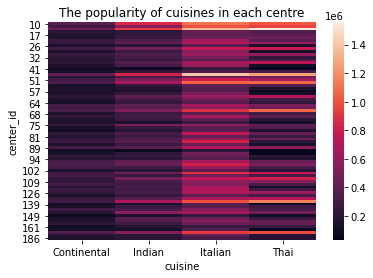

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(center_id_cuisine)
plt.title('The popularity of cuisines in each centre')

From the heatmap, the lighter the color, the more popular the cuisine is. We can tell ingeneral Italian cuisine is more popular while Continental is the least popular in general. It is consistant with the ranked bar chart above.

In [ ]:
center_id_category=pd.pivot_table(train, values='num_orders', index=['center_id'],
                    columns=['category'], aggfunc=np.sum)

In [ ]:
center_id_category

category,Beverages,Biryani,Desert,Extras,Fish,Other Snacks,Pasta,Pizza,Rice Bowl,Salad,Sandwich,Seafood,Soup,Starters
center_id,,,,,,,,,,,,,,
10,1064682.0,23842.0,88379.0,215273.0,49140.0,192677.0,74793.0,171859.0,654944.0,249133.0,350909.0,85294.0,26420.0,133673.0
11,986701.0,8552.0,31636.0,255037.0,17339.0,134127.0,32653.0,125596.0,471042.0,200939.0,359188.0,59975.0,29501.0,85014.0
13,1468872.0,31836.0,64807.0,316567.0,54206.0,270218.0,68832.0,193039.0,757860.0,256264.0,461782.0,120003.0,79784.0,152475.0
14,484662.0,4652.0,13998.0,82782.0,1852.0,31030.0,11114.0,80348.0,178731.0,91652.0,152733.0,29075.0,8788.0,23691.0
17,436871.0,6713.0,18568.0,95766.0,4890.0,60320.0,16170.0,72348.0,187947.0,89192.0,141573.0,36786.0,7014.0,44161.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161,224028.0,5606.0,15300.0,NaN,8741.0,57670.0,14576.0,47976.0,163630.0,54185.0,129867.0,24656.0,NaN,67713.0
162,142935.0,2251.0,18098.0,NaN,NaN,6886.0,7557.0,71422.0,101215.0,135132.0,174877.0,6662.0,NaN,13220.0
174,1182743.0,17173.0,33583.0,78646.0,21159.0,124569.0,33540.0,159252.0,428419.0,171279.0,336595.0,71416.0,58789.0,75424.0


Text(0.5, 1.0, 'The popularity of categories in each centre')

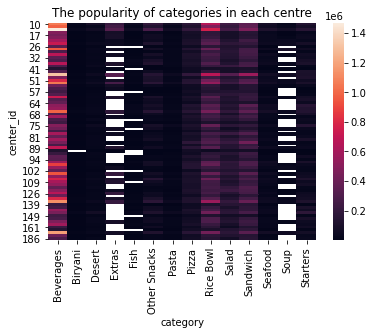

In [ ]:
sns.heatmap(center_id_category)
plt.title('The popularity of categories in each centre')

Beverages is the most popular across all cetnres, then Rice Bowl and Sandwich. It is consistant with the ranked bar chart above. It is worth noticing that some categories such as Biryani, Dessert, Extras, Fish, Pasta, Seafood, Soup and Starters are relatively unpopular, which might be due to the reason that they were not even offered by certain centre or not always available.

### How does the number of order change in all weeks?

In [ ]:
total_by_week=train.groupby('week').sum()
total_by_week=total_by_week.reset_index()
alt.Chart(total_by_week).mark_line().encode(
    x='week',
    y='num_orders',
    tooltip=['week', 'num_orders']
).properties(
    title='The Change in Total Number of Orders by Week'
)

alt.Chart(...)

The number of order is rather stable except that it has a peak at week 48 and a trough at week 62.

### How does the number of order change in weeks in the bestseller centers?

In [ ]:
def plot_center_by_week(id):  
    center_id_week=train[train['center_id']==id].groupby('week').sum()
    center_id_week=center_id_week.reset_index()
    return alt.Chart(center_id_week).mark_line().encode(
        x='week',
        y='num_orders',
        tooltip=['week', 'num_orders']
    ).properties(
    title='The Change in Number of Orders by Week for center_'+str(id)
    )
plot_center_by_week(13)   #from the answer to "Which fulfillment centre (center_id) has the most number of orders"

alt.Chart(...)

The number of order is rather stable except that it has a huge fluctuation from week 60 to 62. Just like the overall order pattern, there is a trough at the week 62.

### How does the number of order change in weeks in the top 5 bestselling centers?

In [ ]:
center_id_week = train[train['center_id'].isin(top_10_number_order['center_id'][:5])].groupby(['week','center_id']).sum()

center_id_week=center_id_week.reset_index()  
alt.Chart(center_id_week).mark_line().encode(
    x='week:Q',
    y='num_orders:Q',
    color = 'center_id:N',
    tooltip=['week', 'num_orders','center_id' ]
).properties(
width=800,
title="The Change in Number of Orders by Week for Top 5 Centers"
)

alt.Chart(...)

The pattern in the number of oreders of the top 5 bestselling centers are similar in general

### What city has the most number of centers?

In [ ]:
city_code_center_id_count=train.groupby('city_code').nunique()
city_code_center_id_count.reset_index(inplace=True)
alt.Chart(city_code_center_id_count).mark_bar().encode(
    x=alt.X('city_code:N', sort='-y'),
    y='center_id'
)

alt.Chart(...)

City 590 and 526 has the highest fulfillment centre count. Other than the top 12 cities, most of the cities have only 1 fulfillment centre.

### What center type have the most numbers of center?

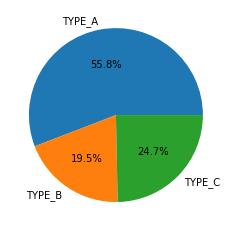

In [ ]:
import matplotlib.pyplot as plt

type_center_count=train.groupby("center_type").nunique()['center_id']
plt.pie(type_center_count,labels=type_center_count.index,autopct='%1.1f%%')
plt.show()

The centre Type A has the most number of centres.

### What is the distribution of checkout_price and base_price

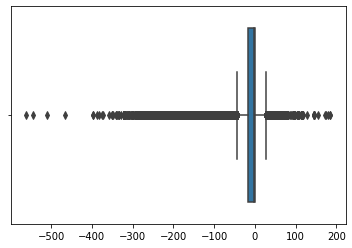

In [ ]:
diff_price=train['checkout_price']-train['base_price']
sns.boxplot(x=diff_price)

In [ ]:
diff_price.describe()

count    456548.000000
mean        -21.917695
std          48.495857
min        -561.600000
25%         -16.520000
50%          -1.000000
75%           1.000000
max         185.300000
dtype: float64

The distribution of the price difference of `checkout_price` and `base_pric` are mostly negative, which means that the checkout price is in general lower than the base price. But there are still some cases where the base price is higher than the checkout price.

### Does emailer_for_promotion affect number of orders?

In [ ]:
from scipy import stats
center_id_t_test=[]
for center_id in train.center_id.unique():
    emailer=train[train['emailer_for_promotion']==1]
    emailer=emailer[emailer['center_id']==center_id].num_orders
    no_emailer=train[train['emailer_for_promotion']==0]
    no_emailer=no_emailer[no_emailer['center_id']==center_id].num_orders
    if stats.ttest_ind(emailer,no_emailer).pvalue>0.05:
        center_id_t_test.append(center_id)
if len(center_id_t_test)==0:
    print("Based on t-test, emailer promotion is working for every center")
else:
    print(center_id_t_test)

Based on t-test, emailer promotion is working for every center


Here we observe the emailer and no-emailer case from the training data samples. The t-test measures whether the average value differs significantly across samples. Since there is no p-value larger than 0.05, we can reject the null hypothesis of equal averages, i.e. emailer promotion is working for every center

## Data Precessing and Standardization

Differentiating the categorical or continuous data:

Categorical data includes:
`week`, `center_id`, `meal_id`, `emailer_for_promotion`, `homepage_featured`

Continuous data includes:
`checkout_price`, `base_price`

In [ ]:
def is_int_float(x):
    try:
        return isinstance(int(x),int) | isinstance(x,float)
    except:
        return False

In [ ]:
continous_columns=[i for i in train.columns if is_int_float(train[i][0])]
continous_columns.remove("id")
continous_columns.remove("num_orders")
category_columns=[i for i in train.columns if not is_int_float(train[i][0])]

In [ ]:
print("Categorical data includes: ", category_columns)
print("Continuous data includes: ", continous_columns)

Categorical data includes:  ['category', 'cuisine', 'center_type']
Continuous data includes:  ['meal_id', 'week', 'center_id', 'checkout_price', 'base_price', 'emailer_for_promotion', 'homepage_featured', 'city_code', 'region_code', 'op_area']


In [ ]:
from sklearn.preprocessing import StandardScaler
X_continuous = train[continous_columns].values
X_discrete = pd.get_dummies(train[category_columns])
discrete_features_dummies = X_discrete.columns.tolist()
X_discrete = X_discrete.values
X=np.concatenate( (X_continuous, X_discrete), axis = 1 )
y=train.num_orders.values

**X_test and y_test are split for validation purpose**

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test=train_test_split(X, y, test_size=0.2, random_state=0)   

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train=scaler.fit_transform(X_train)
X_test=scaler.transform(X_test)

## Model Selector through Grid Search Cross Validation

In [ ]:
from sklearn.model_selection import GridSearchCV
import time
def cross_validation(model,cv_parameters):
    cv_model = GridSearchCV(model, cv_parameters,cv=10)
    
    start_time = time.time()
    cv_model.fit(X_train, y_train)
    end_time = time.time()
    print("Best Parameter: "+str(cv_model.best_params_))
    print("Fit time: " + str(round(end_time - start_time, 2)) + " seconds")
    return cv_model.best_estimator_

#### **Due to the non-linear nature of the data, we did not apply linear regression and tried out various other regressors, including XGboost, light Gradient Boosting and Random Forest. At last, we also try out the neural network.**

## Regression Model 1: XGboost

In [ ]:
# !pip install xgboost
import xgboost as xgb
import numpy as np
xg_reg = xgb.XGBRegressor(objective ='reg:linear')
parameters = {'n_estimators': [100, 140], 'max_depth':[3,5,7,9]}
best_xg=cross_validation(xg_reg,parameters)
best_xg.fit(X_train,y_train)
preds = best_xg.predict(X_test)

[20:40:51] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[20:41:23] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[20:41:54] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[20:42:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[20:42:58] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[20:43:30] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[20:44:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[20:44:34] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of re

In [ ]:
best_xg

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=9, min_child_weight=1, missing=None, n_estimators=140,
             n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
             silent=None, subsample=1, verbosity=1)

### Model Evaluation

In [ ]:
preds_train = best_xg.predict(X_train)
preds_test = best_xg.predict(X_test)

In [ ]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score

print("Training R2 value")
r2_value=r2_score(y_train,preds_train)
mean_squared=mean_squared_error(y_train,preds_train)
print("r2_value: "+str(r2_value))
print("mean_squared_error: "+str(mean_squared))

print()
print("Testing R2 value")
r2_value=r2_score(y_test,preds_test)
mean_squared=mean_squared_error(y_test,preds_test)
print("r2_value: "+str(r2_value))
print("mean_squared_error: "+str(mean_squared))

Training R2 value
r2_value: 0.9309400276905471
mean_squared_error: 10832.627338272512

Testing R2 value
r2_value: 0.8813733141086103
mean_squared_error: 18546.035664291176


We tried to visualize the result with sample of 5000 data points are selected for plotting. The chart below is plotting the actual value against the predicted value.

In [ ]:
source=pd.DataFrame({"actual":y_test,"preds":preds_test})
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='actual'
)

alt.Chart(...)

Except for a few outliers, the actual-prediction chart shows a match of the actual and prediction value for majority of the data. It acts as the accuracy reference as well.

In [ ]:
source["residuals"] = source["actual"] - source["preds"]
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='residuals'
)

alt.Chart(...)

The residual chart shows the "deviation from demand forecast", and it seems that most of the deviation is within the range of positive to negative 500 orders per week.

We can also observe from the graph that those larger predicted value tend to have larger residual value, i.e. There might be error when predicting the large, outlying number of orders.

## Regression Model 2a: Light GBM (Gradient Boosting) Model (with the same hyperparameters as XGboost)

In [ ]:
from lightgbm import LGBMRegressor
#boosting_type (string, optional (default='gbdt')) – ‘gbdt’, traditional Gradient Boosting Decision Tree
lgb_reg = LGBMRegressor()
parameters = {'n_estimators': [100, 140], 'max_depth':[3,5,7,9]}
best_lgb=cross_validation(lgb_reg,parameters)
best_lgb.fit(X_train,y_train)

Best Parameter: {'max_depth': 9, 'n_estimators': 140}
Fit time: 261.07 seconds


LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=9,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=140, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

### Model Evaluation

In [ ]:
lgb_preds_train = best_lgb.predict(X_train)
lgb_preds_test = best_lgb.predict(X_test)

In [ ]:
# from sklearn.metrics import r2_score
# from sklearn.metrics import mean_squared_error
# from sklearn.metrics import explained_variance_score

print("Training R2 value")
r2_value=r2_score(y_train,lgb_preds_train)
mean_squared=mean_squared_error(y_train,lgb_preds_train)
print("r2_value: "+str(r2_value))
print("mean_squared_error: "+str(mean_squared))

print()
print("Testing R2 value")
r2_value=r2_score(y_test,lgb_preds_test)
mean_squared=mean_squared_error(y_test,lgb_preds_test)
print("r2_value: "+str(r2_value))
print("mean_squared_error: "+str(mean_squared))

Training R2 value
r2_value: 0.8385167569120713
mean_squared_error: 25329.981105534833

Testing R2 value
r2_value: 0.8219863531563214
mean_squared_error: 27830.562898099357


In [ ]:
source=pd.DataFrame({"actual":y_test,"preds":lgb_preds_test})
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='actual'
)

alt.Chart(...)

Except for a few outliers, the actual-prediction chart shows a match of the actual and prediction value for majority of the data. It shows good accuracy with the light GBM model.

In [ ]:
source["residuals"] = source["actual"] - source["preds"]
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='residuals'
)

alt.Chart(...)

The residual chart shows the "deviation from demand forecast", and it seems that most of the deviation is within the range of positive to negative 500 orders per week. 

Compared to the XGBoost model of same n_estimators and max depth of tree, the light GBM model seems to have more divergence in residual value than the XGBoost model.

It also shows larger residual value when predicted value is larger.

## Regression Model 2b: Light GBM (Gradient Boosting) Model (with higher n_estimators)

As light GBM takes less resources to run, we can test the n_estimator to 1000 for better result, which still takes less time as xgboost is running

In [ ]:
from lightgbm import LGBMRegressor
#boosting_type (string, optional (default='gbdt')) – ‘gbdt’, traditional Gradient Boosting Decision Tree
lgb_reg = LGBMRegressor()
parameters = {'n_estimators': [100, 200, 500, 1000], 'max_depth':[3,5,7,9]}
best_lgb=cross_validation(lgb_reg,parameters)
best_lgb.fit(X_train,y_train)

Best Parameter: {'max_depth': 9, 'n_estimators': 1000}
Fit time: 1870.84 seconds


LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=9,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=1000, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

### Model Evaluation

In [ ]:
lgb_preds_train = best_lgb.predict(X_train)
lgb_preds_test = best_lgb.predict(X_test)

In [ ]:
print("Training R2 value")
r2_value=r2_score(y_train,lgb_preds_train)
mean_squared=mean_squared_error(y_train,lgb_preds_train)
print("r2_value: "+str(r2_value))
print("mean_squared_error: "+str(mean_squared))

print()
print("Testing R2 value")
r2_value=r2_score(y_test,lgb_preds_test)
mean_squared=mean_squared_error(y_test,lgb_preds_test)
print("r2_value: "+str(r2_value))
print("mean_squared_error: "+str(mean_squared))

Training R2 value
r2_value: 0.9185367345687572
mean_squared_error: 12778.186359837848

Testing R2 value
r2_value: 0.8850546373951377
mean_squared_error: 17970.499456306487


In [ ]:
source=pd.DataFrame({"actual":y_test,"preds":lgb_preds_test})
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='actual'
)

alt.Chart(...)

Compared to the XGBoost and light GBM model with smaller hyperparameter value of n_estimators, the actual-prediction plot of light GBM model with 1000 n_estimators has been more aligned with the desired positive linearity pattern.

In [ ]:
source["residuals"] = source["actual"] - source["preds"]
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='residuals'
)

alt.Chart(...)

Compared to the light GBM model of smaller n_estimator value and XGBoost model, the residual chart of the light GBM model (n_estimator =1000) has most rediduals within 500 orders' range.

## Regression Model 3: Random Forest Regressor

In [ ]:
from sklearn.ensemble import RandomForestRegressor
regr = RandomForestRegressor(random_state=0)
parameters = {'max_depth': [2,3], 'min_samples_leaf':[3,4]}
best_rf=cross_validation(regr,parameters)
best_rf.fit(X_train,y_train)

Best Parameter: {'max_depth': 3, 'min_samples_leaf': 3}
Fit time: 2339.43 seconds


RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=3, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=3,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=0, verbose=0, warm_start=False)

### Model Evaluation

In [ ]:
rf_preds_train = best_rf.predict(X_train)
rf_preds_test = best_rf.predict(X_test)

In [ ]:
print("Training R2 value")
r2_value=r2_score(y_train,rf_preds_train)
mean_squared=mean_squared_error(y_train,rf_preds_train)
print("r2_value: "+str(r2_value))
print("mean_squared_error: "+str(mean_squared))

print()
print("Testing R2 value")
r2_value=r2_score(y_test,rf_preds_test)
mean_squared=mean_squared_error(y_test,rf_preds_test)
print("r2_value: "+str(r2_value))
print("mean_squared_error: "+str(mean_squared))

Training R2 value
r2_value: 0.2920902998521634
mean_squared_error: 111041.48632564802

Testing R2 value
r2_value: 0.30414104118649066
mean_squared_error: 108790.23527039785


In [ ]:
source=pd.DataFrame({"actual":y_test,"preds":rf_preds_test})
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='actual'
)

alt.Chart(...)

The relationship between the actual and prediction values are not positive linear, which shows quite low accuracy in the predictive power of the random forest model in this case.

In [ ]:
source["residuals"] = source["actual"] - source["preds"]
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='residuals'
)

alt.Chart(...)

The residual value is quite diverged, mostly within plus or minus 3000 orders per week but some can deviate up to more than 6000 orders. It is not suggested to apply such model for forecasting the demand or else there might be mis-planning in food / human resource allocation.

## Deep Learning Model: Neural Network

In [ ]:
# !pip install tensorflow
# !pip install keras


from os import listdir
from keras.preprocessing import sequence
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Dropout , Activation, Lambda, Flatten
from keras.layers import LSTM

from keras.optimizers import Adam, RMSprop
from keras.models import load_model
from keras.callbacks import ModelCheckpoint


from keras.wrappers.scikit_learn import KerasRegressor

from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

Data preprocessing separately for Neural Network, so as to avoid messing up from the previous regression models.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

#to avoid data messing up with previous regression model, create the splitted test and validation data again
X_train, X_test, y_train, y_test=train_test_split(X, y, test_size=0.2, random_state=0)  

scaler = MinMaxScaler()
X_train=scaler.fit_transform(X_train)
X_test=scaler.transform(X_test)

In [ ]:
# Convert data as np.array
features = np.array(X_train)
targets = np.array(y_train.reshape(y_train.shape[0],1))
features_validation= np.array(X_test)
targets_validation = np.array(y_test.reshape(y_test.shape[0],1))
features.shape

(365238, 31)

In [ ]:
# Building the model
model = Sequential()

#build the model with inital input dimension as 31 = column numbers in input data X
model.add(Dense(256, input_dim=31, activation='relu'))
model.add(Dropout(.2))                                  #Dropout: to avoid overfitting, it will take out a certain % of input in each neural connection
model.add(Dense(256, activation='relu'))
model.add(Dense(128))
model.add(Dense(128, activation='relu'))
model.add(Dense(1))

# Compiling the model
adam = Adam(lr=0.01, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0)
model.compile(loss='mean_squared_error', optimizer=adam, metrics='mse')

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 256)               8192      
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               65792     
_________________________________________________________________
dense_2 (Dense)              (None, 128)               32896     
_________________________________________________________________
dense_3 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 129       
Total params: 123,521
Trainable params: 123,521
Non-trainable params: 0
__________________________________________________

In [ ]:
# Training the model

epochs_tot = 200
epochs_step = 50
epochs_ratio = int(epochs_tot / epochs_step)
hist =np.array([])

for i in range(epochs_ratio):
    history = model.fit(features, targets, epochs=epochs_step, batch_size=100, verbose=1)
    
    # Evaluating the model on the training and testing set
    print("Step : " , i * epochs_step, "/", epochs_tot)
    score = model.evaluate(features, targets)
    print("Training MSE:", score[1])
    score = model.evaluate(features_validation, targets_validation)
    print("Validation MSE:", score[1], "\n")


Epoch 1/50
3653/3653 [==============================] - 21s 6ms/step - loss: 57818.7969 - mse: 57818.7969
Epoch 2/50
3653/3653 [==============================] - 21s 6ms/step - loss: 56344.0820 - mse: 56344.0820
Epoch 3/50
3653/3653 [==============================] - 21s 6ms/step - loss: 52998.4844 - mse: 52998.4844
Epoch 4/50
3653/3653 [==============================] - 20s 6ms/step - loss: 53931.2773 - mse: 53931.2773
Epoch 5/50
3653/3653 [==============================] - 21s 6ms/step - loss: 51709.5703 - mse: 51709.5703
Epoch 6/50
3653/3653 [==============================] - 21s 6ms/step - loss: 50946.6133 - mse: 50946.6133
Epoch 7/50
3653/3653 [==============================] - 21s 6ms/step - loss: 51422.5586 - mse: 51422.5586
Epoch 8/50
3653/3653 [==============================] - 21s 6ms/step - loss: 50833.5234 - mse: 50833.5234
Epoch 9/50
3653/3653 [==============================] - 21s 6ms/step - loss: 49789.2852 - mse: 49789.2852
Epoch 10/50
3653/3653 [=======================

In [ ]:
# Training the model

epochs_tot = 150
epochs_step = 50
epochs_ratio = int(epochs_tot / epochs_step)
hist =np.array([])

for i in range(epochs_ratio):
    history = model.fit(features, targets, epochs=epochs_step, batch_size=100, verbose=1)
    
    # Evaluating the model on the training and testing set
    print("Step : " , i * epochs_step, "/", epochs_tot)
    score = model.evaluate(features, targets)
    print("Training MSE:", score[1])
    score = model.evaluate(features_validation, targets_validation)
    print("Validation MSE:", score[1], "\n")


Epoch 1/50
3653/3653 [==============================] - 22s 6ms/step - loss: 82169.0173 - mse: 82169.0198
Epoch 2/50
3653/3653 [==============================] - 21s 6ms/step - loss: 60582.8731 - mse: 60582.8731
Epoch 3/50
3653/3653 [==============================] - 21s 6ms/step - loss: 56364.2514 - mse: 56364.2514
Epoch 4/50
3653/3653 [==============================] - 21s 6ms/step - loss: 52609.6596 - mse: 52609.6596
Epoch 5/50
3653/3653 [==============================] - 21s 6ms/step - loss: 53075.2325 - mse: 53075.2325
Epoch 6/50
3653/3653 [==============================] - 21s 6ms/step - loss: 56011.1845 - mse: 56011.1845
Epoch 7/50
3653/3653 [==============================] - 21s 6ms/step - loss: 52310.9599 - mse: 52310.9599
Epoch 8/50
3653/3653 [==============================] - 21s 6ms/step - loss: 50149.0183 - mse: 50149.0183
Epoch 9/50
3653/3653 [==============================] - 21s 6ms/step - loss: 48942.6261 - mse: 48942.6248
Epoch 10/50
3653/3653 [=======================

### Model Evaluation

epoch tot = 200

In [ ]:
nn_preds_train = model.predict(X_train)
nn_preds_test = model.predict(X_test)
print("Training R2 value")
r2_value_nn=r2_score(y_train,nn_preds_train)
mean_squared_nn=mean_squared_error(y_train,nn_preds_train)
print("r2_value: "+str(r2_value_nn))
print("mean_squared_error: "+str(mean_squared_nn))

print()
print("Testing R2 value")
r2_value_nn=r2_score(y_test,nn_preds_test)
mean_squared_nn=mean_squared_error(y_test,nn_preds_test)
print("r2_value: "+str(r2_value_nn))
print("mean_squared_error: "+str(mean_squared_nn))

Training R2 value
r2_value: 0.7220959385000432
mean_squared_error: 43591.5485244023

Testing R2 value
r2_value: 0.718639128958985
mean_squared_error: 43987.81530186408


epoch tot = 150

In [ ]:
nn_preds_train = model.predict(X_train)
nn_preds_test = model.predict(X_test)
print("Training R2 value")
r2_value_nn=r2_score(y_train,nn_preds_train)
mean_squared_nn=mean_squared_error(y_train,nn_preds_train)
print("r2_value: "+str(r2_value_nn))
print("mean_squared_error: "+str(mean_squared_nn))

print()
print("Testing R2 value")
r2_value_nn=r2_score(y_test,nn_preds_test)
mean_squared_nn=mean_squared_error(y_test,nn_preds_test)
print("r2_value: "+str(r2_value_nn))
print("mean_squared_error: "+str(mean_squared_nn))

Training R2 value
r2_value: 0.7841745742720321
mean_squared_error: 33854.00151275572

Testing R2 value
r2_value: 0.774457034344668
mean_squared_error: 35261.272397877874


In [ ]:
nn_preds_test_flat = [item for sublist in nn_preds_test for item in sublist]

In [ ]:
alt.data_transformers.disable_max_rows()

source=pd.DataFrame({"actual":y_test,"preds":nn_preds_test_flat})
alt.Chart(source).mark_point().encode(
    x='preds',
    y='actual'
)

alt.Chart(...)

In [ ]:
source=pd.DataFrame({"actual":y_test,"preds":nn_preds_test_flat})
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='actual'
)

alt.Chart(...)

In [ ]:
source["residuals"] = source["actual"] - source["preds"]
alt.Chart(source).mark_point().encode(
    x='preds',
    y='residuals'
)

alt.Chart(...)

In [ ]:
source["residuals"] = source["actual"] - source["preds"]
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='residuals'
)

alt.Chart(...)

The number of R2 score is only 0.72 and MSE for neural network reaches around 44000. It does not show good result as the other model. While we tried out LSTM as well, the performance is not good as well. One possible reason could be that neural network is not the best for predicting with this dataset.

In [ ]:
nn_preds_test_flat = [item for sublist in nn_preds_test for item in sublist]

In [ ]:
alt.data_transformers.disable_max_rows()

source=pd.DataFrame({"actual":y_test,"preds":nn_preds_test_flat})
alt.Chart(source).mark_point().encode(
    x='preds',
    y='actual'
)

alt.Chart(...)

In [ ]:
source=pd.DataFrame({"actual":y_test,"preds":nn_preds_test_flat})
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='actual'
)

alt.Chart(...)

While the actual and predicted points do show positive linearity, more of the oints are diverged from the slope of 1 compared to other models.

In [ ]:
source["residuals"] = source["actual"] - source["preds"]
alt.Chart(source).mark_point().encode(
    x='preds',
    y='residuals'
)

alt.Chart(...)

In [ ]:
source["residuals"] = source["actual"] - source["preds"]
alt.Chart(source[:5000]).mark_point().encode(
    x='preds',
    y='residuals'
)

alt.Chart(...)

The residual values are more diverged from 0 compared to other models. It also shows tendency that the residuals are more spreaded out when the predicted values are larger.

## Model Comparision.

Among the 4 regression models, the r2 score of Random Forest is the smallest. The error rate is the highest as well.


At the same hyperparameter `n_estimator` value = 140 and depth = 9, XGboost has slightly better performance in r2 score and mean squared error rate than light GBM, but it has significantly longer running time.


If we increase the `n_estimator` to 1000 for light GBM, it has slightly higher r2 score and smaller mean square error, yet the time trained is less than XGBoost.


Finally, we tried out the Neural Network Model. As we can see that the R2 and MSE value are not quite close to the Xgboost or light GBM model. Therefore, we will not implement the Neural Network model for prediction.


Overall, the performance of xgboost and light GBM are quite close. We then compare the below training r2 value and validation r2 value, and it seems that light GBM has closer training and validation r2 values, which might indicate less possiblity of overfitting. Therefore, we will pick light GBM with n_estimator of 1000 as our final model if only one is to be used for prediction.



| Model | r2 value (training) | r2 value (validation) | MSE (validation) | time taken (reference only, not the same cross validations parameters for all models) |
| --- | --- | --- | --- | --- |
XGBoost (n_estimator=140,max_depth=9) | 0.931 | 0.881 | 18546 | 6541.25 seconds |
light GBM (n_estimator=140,max_depth=9) | 0.839 | 0.822 | 27831 | 261.07 seconds |
light GBM (n_estimator=1000,max_depth=9) | 0.919 | 0.885 | 17970 | 1870.84 seconds |
Random Forest | 0.292 | 0.304 | 108790 | 2339.43 seconds |
Neural Network | 0.722 | 0.719 | 43988 | N/A |


## Prediction on the Test dataset and Result Visualization

Among the 3 regressors we used, the XGBoost model and light GMB (n_estimator=1000) has lowest Mean Square Error. Below are applying the two shortlisted two regression models for actual prediction on the test set and visualisation.

**i) First apply the same preprocessing to standardize the test dataset, as we do for training set, except that it does not have "num_orders" to be removed.**

In [ ]:
continous_columns=[i for i in test.columns if is_int_float(train[i][0])]
continous_columns.remove("id")
category_columns=[i for i in test.columns if not is_int_float(train[i][0])]

In [ ]:
# from sklearn.preprocessing import StandardScaler
X_continuous = test[continous_columns].values
X_discrete = pd.get_dummies(test[category_columns])
discrete_features_dummies = X_discrete.columns.tolist()
X_discrete = X_discrete.values
X_test=np.concatenate( (X_continuous, X_discrete), axis = 1 )

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train=scaler.fit_transform(X)   #X=np.concatenate( (X_continuous, X_discrete), axis = 1 ) from previous data preprocess part
X_test=scaler.transform(X_test)
y_train=train['num_orders'].values

## Predict with xgboost model
**ii)**

**Fit the best version of XGboost model selected (with Best Parameter: {'max_depth': 9, 'n_estimators': 140}), with the entire training dataset**

**Then predict the number of orders in the coming few weeks with test dataset**

In [ ]:
import xgboost as xgb
best_xgb_reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=9, min_child_weight=1, missing=None, n_estimators=140,
             n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
             silent=None, subsample=1, verbosity=1)

best_xgb_reg.fit(X_train, y_train)
best_xgb_preds_train = best_xgb_reg.predict(X_train)
best_xgb_y_pred = best_xgb_reg.predict(X_test)

[00:13:01] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [ ]:
best_xgb_preds_train_df = pd.DataFrame(best_xgb_preds_train, columns = ['predicted_orders'])
xgb_predicted_train = pd.merge(train,best_xgb_preds_train_df,left_index=True, right_index=True, how='inner')
xgb_predicted_train_by_week_by_center = pd.DataFrame(xgb_predicted_train.groupby(['week','center_id'],as_index=False)['num_orders','predicted_orders'].sum())
xgb_predicted_train_by_week_by_center

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  This is separate from the ipykernel package so we can avoid doing imports until


,week,center_id,num_orders,predicted_orders
0,1,10,25327,23694.953125
1,1,11,17636,17380.626953
2,1,13,29531,29209.232422
3,1,14,9216,9218.284180
4,1,17,8246,8327.906250
...,...,...,...,...
11135,145,161,4720,4647.326172
11136,145,162,4017,3856.394531
11137,145,174,15409,16250.421875
11138,145,177,5669,5760.199219


In [ ]:
alt.data_transformers.disable_max_rows()
alt.Chart(xgb_predicted_train_by_week_by_center).mark_point().encode(
    x='predicted_orders',
    y='num_orders'
)

alt.Chart(...)

In [ ]:
xgb_predicted_train_by_week_by_center["residuals"] = xgb_predicted_train_by_week_by_center["num_orders"] - xgb_predicted_train_by_week_by_center["predicted_orders"]
alt.Chart(xgb_predicted_train_by_week_by_center).mark_point().encode(
    x='predicted_orders',
    y='residuals'
)

alt.Chart(...)

In [ ]:
abs(xgb_predicted_train_by_week_by_center["residuals"]).describe()

count    11140.000000
mean       686.667480
std        656.619751
min          0.049805
25%        238.314575
50%        506.184814
75%        926.429443
max       6900.487305
Name: residuals, dtype: float64

**iii) Combine the known weekly order and the predicted order number**

In [ ]:
known_orders = pd.DataFrame(train.groupby(['week'])['num_orders'].sum())

In [ ]:
new_columns = ['num_orders']
best_xgb_y_pred_df = pd.DataFrame(best_xgb_y_pred, columns = new_columns)
xgb_predicted_orders = pd.merge(test,best_xgb_y_pred_df,left_index=True, right_index=True, how='inner')
xgb_y_pred_orders = pd.DataFrame(xgb_predicted_orders.groupby(['week'])['num_orders'].sum())
xgb_y_pred_orders

,num_orders
week,
146,662650.0625
147,778140.0625
148,688764.6875
149,708251.1250
150,951925.1875
151,936850.5000
152,949246.7500
153,905812.7500
154,796919.4375


In [ ]:
source = pd.concat([known_orders,xgb_y_pred_orders])
source = source.reset_index()

**iv) Visualize the prediction as an extension of the known, training data**

In [ ]:
alt.Chart(source).mark_line(point=True).encode(
    x='week',
    y='num_orders',
    tooltip=['week', 'num_orders'],
    color=alt.condition(alt.datum.week>145, alt.ColorValue('red'), alt.ColorValue('blue')),
).properties(
    title='The Change in Total Number of Orders by Week - prediceted by xgboost',
    width=1000
)

alt.Chart(...)

From this chart, we can see that the predicted number of orders in week 146-149 remains low at around 663k to 708k. Then it will have a rise in week 150, reaching 952k orders, stayed at the level for 4 weeks, and then fall to around 780-790k per week in week 154 and 155.

**v) visualize the prediction by center**

In [ ]:
xgb_y_pred_orders_by_center = pd.DataFrame(xgb_predicted_orders.groupby(['week','center_id'])['num_orders'].sum())
known_orders_by_center = pd.DataFrame(train.groupby(['week','center_id'])['num_orders'].sum())
xgb_orders_by_center = pd.concat([known_orders_by_center,xgb_y_pred_orders_by_center])
xgb_orders_by_center = xgb_orders_by_center.reset_index()

In [ ]:
def display_order_by_center(center_id, orders_by_center):
  '''
  input the center id and the dataframe that contains the per-center, per-week data to plot specific charts
  '''
  source = orders_by_center[orders_by_center["center_id"]==center_id]
  line = alt.Chart(source).mark_line(point=True).encode(
      x='week',
      y='num_orders',
      tooltip=['week', 'num_orders'],
      color=alt.condition(alt.datum.week>145, alt.ColorValue('red'), alt.ColorValue('blue')),
  ).properties(
      title='The Change in Number of Orders by Week at center {}'.format(center_id),
      width=1000
  )
  return line

In [ ]:
display_order_by_center(13, xgb_orders_by_center)

alt.Chart(...)

By inputing the center_id, managers can check the forecast of specific center and make related operations decisions. Here center 13 is shown as an example since it is the top-selling center according to the previous exploratory analysis.

## Predict with light GBM model
**ii)**

**Fit the best version of light GBM model selected (with Best Parameter: {'max_depth': 9, 'n_estimators': 1000}), with the entire training dataset**

**Then predict the number of orders in the coming few weeks with test dataset**

In [ ]:
from lightgbm import LGBMRegressor
best_lgb_reg = LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=9,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=1000, n_jobs=-1, num_leaves=31, objective=None,
              random_state=0, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0)
best_lgb_reg.fit(X_train, y_train)
best_lgb_y_pred = best_lgb_reg.predict(X_test)
best_lgb_y_pred

array([263.4732794 , 263.4732794 , 294.73672045, ...,  33.97732178,
        41.10525646,  41.10525646])

**iii) Visualize the prediction as an extension of the known, training data**

In [ ]:
best_lgb_y_pred_df = pd.DataFrame(best_lgb_y_pred, columns = ['num_orders'])
lgb_predicted_orders = pd.merge(test,best_lgb_y_pred_df,left_index=True, right_index=True, how='inner')
lgb_y_pred_orders = pd.DataFrame(lgb_predicted_orders.groupby(['week'])['num_orders'].sum())
lgb_y_pred_orders

,num_orders
week,
146,649204.858945
147,753855.012112
148,680636.614553
149,699201.626745
150,946003.086795
151,938287.999638
152,919828.473886
153,874337.557835
154,808424.374508


In [ ]:
source = pd.concat([known_orders,lgb_y_pred_orders])
source = source.reset_index()

**iv) Visualize the prediction as an extension of the known, training data**

In [ ]:
alt.Chart(source).mark_line(point=True).encode(
    x='week',
    y='num_orders',
    tooltip=['week', 'num_orders'],
    color=alt.condition(alt.datum.week>145, alt.ColorValue('red'), alt.ColorValue('blue')),
).properties(
    title='The Change in Total Number of Orders by Week - predicted by light GBM',
    width=1000
)

alt.Chart(...)

The demand trendline predicted by light GBM is in fact quite close to XGBoost. The predicted number of orders in week 146-149 remains low and there is a rise of more than 200k order numbers in week 150, reaching 946k orders. It then starts to drop gradually and fall to around 798k orders pre week.

In order to fulfill the demand at week 150, the meal delivery company can on-board flexible delivery partners in advance. 

**v) visualize the prediction by center**

In [ ]:
lgb_y_pred_orders_by_center = pd.DataFrame(lgb_predicted_orders.groupby(['week','center_id'])['num_orders'].sum())
# known_orders_by_center = pd.DataFrame(train.groupby(['week','center_id'])['num_orders'].sum())
lgb_orders_by_center = pd.concat([known_orders_by_center,lgb_y_pred_orders_by_center])
lgb_orders_by_center = lgb_orders_by_center.reset_index()

In [ ]:
display_order_by_center(13, lgb_orders_by_center)

alt.Chart(...)

By inputing the center_id, managers can check the forecast of specific center and make related operations decisions. Here center 13 is shown as an example since it is the top-selling center according to the previous exploratory analysis.

Here we can observe that the numbers predicted with XGBoost and light GBM are very close to each other.

## Summary of insights

#### **Labour allocation**
Based on the analysis, the prediction made by the XGBoost and light GBM models would have 2000 order fluctuation per week per center, which will be 285 order per day per center.

In order to cover up for the potential lost sales, the food delivery company can hire flexible buffer labours as regular support. Assume each order takes around 15 minutes to deliver on average (assume some are further away and some are close by, and some orders are delivered to near neighbourhood) , taking into account the break time, a part-time delivery partner who works 4 hours a day can deliver around 15 orders a day. 

i.e. To allow buffer in supply, 19 stand-by delivery partners can be hired per center.

#### **Center relocation or location**
For this company, the fulfillment centers are owned by the company itself. If there are constant decrease in the number of orders in some centers, the company can consider relocate some of the centers to accomodate for the shift in demand. With the same logic, we can also build the center if the local meal prediction is exceeding the center limit.

## Next Steps
### **Performance**
Even though the r2 score is around 0.9 for regression analysis, to further improve the model performance, we can still modify the hyperparameters to fit the model better, say increase the n_estimator or reduce the learning rate. But it also has to balance with the overfitting issue, so the r2 score of training data and validation data should be compared closely.

By increasing hyperparameter values, it can also substantially increase the training time and thus might need to trade-off with the time efficiency too.

#### **Predictive analytics service**

In case of platform business such as UberEat and Instacart, they would collect per-restaurant order data. The predictive analytics and order insights can be shared with the restaurants as extra analytics service and act as another source of revenue. On that way, we can also do complementary analysis on the data at restaurant-scale along with the distribution center data.